In [1]:
from mpl_toolkits import mplot3d
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

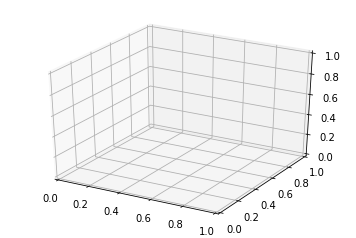

In [3]:
fig=plt.figure()
ax=plt.axes(projection='3d')

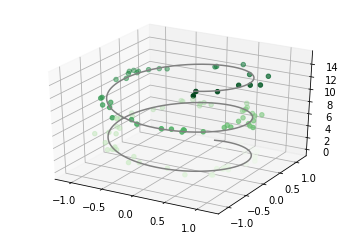

In [7]:
#3D points and lines 
ax=plt.axes(projection='3d')
#Data for a 3d line
zline=np.linspace(0,15,1000)
xline=np.sin(zline)
yline=np.cos(zline)
ax.plot3D(xline, yline, zline, 'gray')
#Data for 3d scattered points
zdata=15*np.random.random(100)
xdata=np.sin(zdata)+0.1*np.random.randn(100)
ydata=np.cos(zdata)+0.1*np.random.randn(100)
ax.scatter3D(xdata, ydata, zdata, c=zdata, cmap='Greens')

Text(0.5,0,'z')

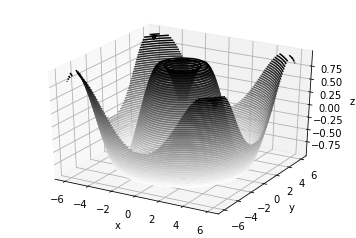

In [9]:
#3D contour plots
def f(x,y):
    return np.sin(np.sqrt(x**2+y**2))
x=np.linspace(-6,6,30)
y=np.linspace(-6,6,30)
X,Y=np.meshgrid(x,y)
Z=f(X,Y)
fig=plt.figure()
ax=plt.axes(projection='3d')
ax.contour3D(X,Y,Z,50, cmap='binary')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

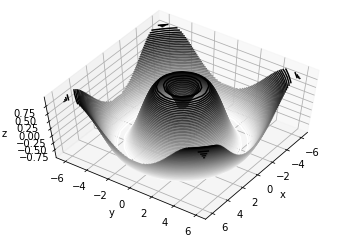

In [10]:
ax.view_init(60,35)
fig

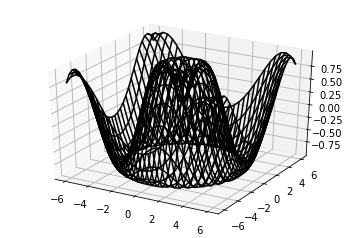

In [11]:
#Wireframes and surface plots
#WIREFRAME PLOT
fig=plt.figure()
ax=plt.axes(projection='3d')
ax.plot_wireframe(X,Y,Z, color='black')

Text(0.5,0.92,'surface plot')

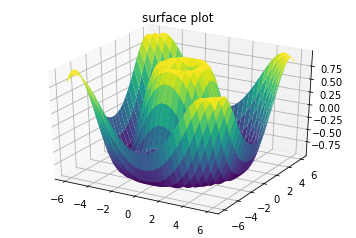

In [15]:
#Surface okir
ax=plt.axes(projection='3d')
ax.plot_surface(X,Y,Z, rstride=1, cstride=1, 
                cmap='viridis', edgecolor='none')
ax.set_title('surface plot')

In [18]:
#Surface triangulations
theta=2*np.pi*np.random.random(1000)
r=6*np.random.random(1000)
x=np.ravel(r*np.sin(theta))
y=np.ravel(r*np.cos(theta))
z=f(x,y)

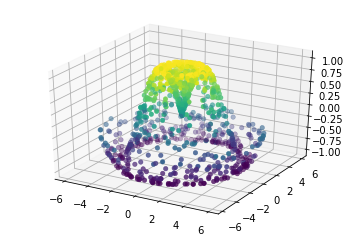

In [19]:
ax=plt.axes(projection='3d')
ax.scatter(x,y,z, c=z, cmap='viridis', linewidth=0.5)

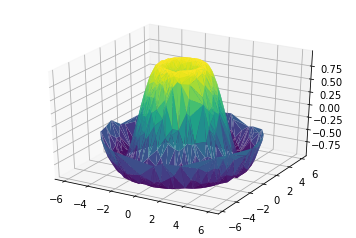

In [20]:
#ax.plot_trisurf()
ax=plt.axes(projection='3d')
ax.plot_trisurf(x,y,z, cmap='viridis', edgecolor='none')

In [1]:
#Geographic Data WITH BASEMAP
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

In [2]:
#Find the epsg file 
import os
os.environ["PROJ_LIB"] = "C:\\Users\\chrag\\Anaconda3\\Library\\share"
from mpl_toolkits.basemap import Basemap

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


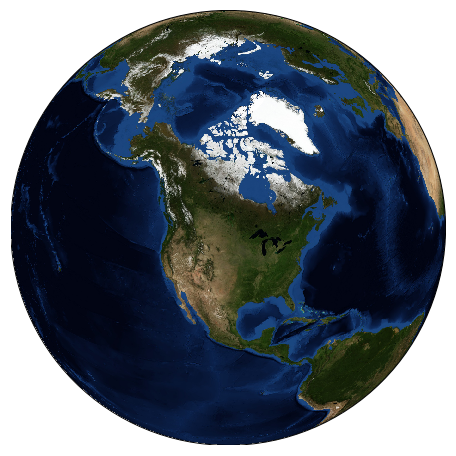

In [3]:
plt.figure(figsize=(8,8))
m=Basemap(projection='ortho', resolution=None, lat_0=50, lon_0=-100)
m.bluemarble(scale=0.8)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(2.34727e+06,4.51808e+06,'Seattle')

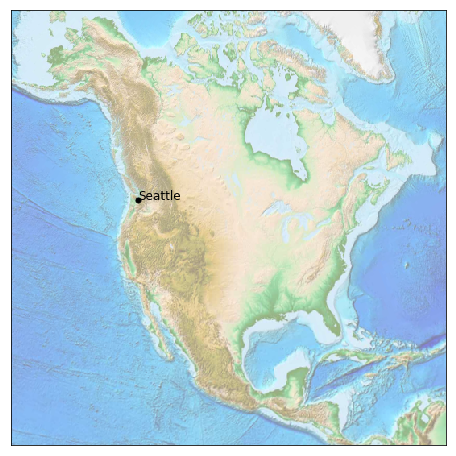

In [4]:
fig=plt.figure(figsize=(8,8))
m=Basemap(projection='lcc', resolution=None,
         width=8E6, height=8E6,
         lat_0=45, lon_0=-100)
m.etopo(scale=0.5, alpha=0.5)

# MAP (LONG, LAT) TO (X,Y) for plotting
x,y=m(-122.3,47.6)
plt.plot(x,y, 'ok',markersize=5)
plt.text(x,y, 'Seattle', fontsize=12)

In [5]:
#Map projections
#Draw longtitude and latitude lines for our world map

from itertools import chain

def draw_map(m, scale=0.2):
    # draw a shaded-relief image
    m.shadedrelief(scale=scale)
    
    # lats and longs are returned as a dictionary
    lats = m.drawparallels(np.linspace(-90, 90, 13))
    lons = m.drawmeridians(np.linspace(-180, 180, 13))

    # keys contain the plt.Line2D instances
    lat_lines = chain(*(tup[1][0] for tup in lats.items()))
    lon_lines = chain(*(tup[1][0] for tup in lons.items()))
    all_lines = chain(lat_lines, lon_lines)
    
    # cycle through these lines and set the desired style
    for line in all_lines:
        line.set(linestyle='-', alpha=0.3, color='w')

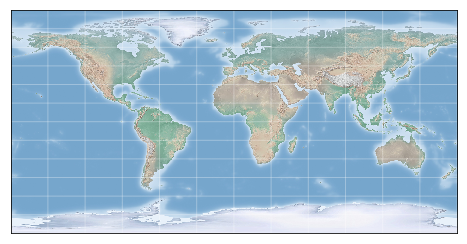

In [37]:
#Cylindrical projections
fig=plt.figure(figsize=(8,6),edgecolor='w')
m=Basemap(projection='cyl',resolution=None, 
         llcrnrlat=-90, urcrnrlat=90,
         llcrnrlon=-180, urcrnrlon=180)
draw_map(m)

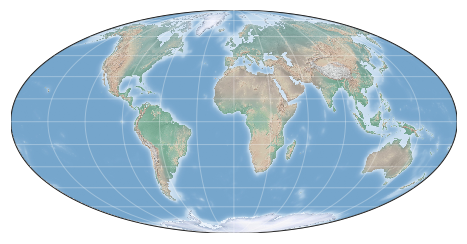

In [38]:
#Pseudo-cyclindrical projections
fig = plt.figure(figsize=(8, 6), edgecolor='w')
m = Basemap(projection='moll', resolution=None,
            lat_0=0, lon_0=0)
draw_map(m)

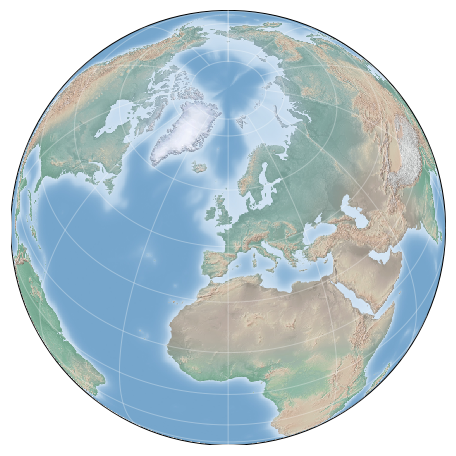

In [39]:
#Perspective projections using a particular choice of perpective point
fig = plt.figure(figsize=(8, 8))
m = Basemap(projection='ortho', resolution=None,
            lat_0=50, lon_0=0)
draw_map(m);

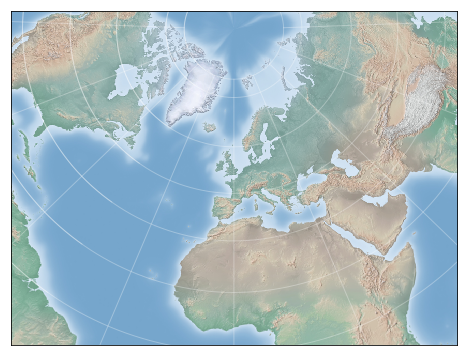

In [40]:
#Connic projection
fig = plt.figure(figsize=(8, 8))
m = Basemap(projection='lcc', resolution=None,
            lon_0=0, lat_0=50, lat_1=45, lat_2=55,
            width=1.6E7, height=1.2E7)
draw_map(m)

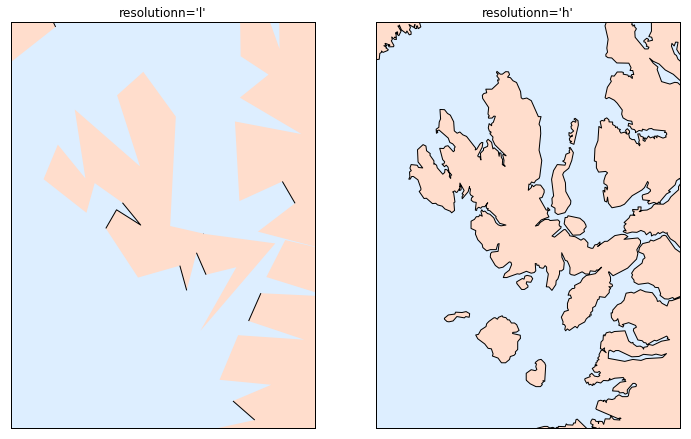

In [6]:
#Isle of skye 57.3 N, 6.2 W/ a map of 90,000*120,000 km
fig, ax=plt.subplots(1,2, figsize=(12,8))
for i, res in enumerate(['l','h']):
    m=Basemap(projection='gnom', lat_0=57.3, lon_0=-6.2,
             width=90000, height=120000, resolution=res, ax=ax[i])
    m.fillcontinents(color='#FFDDCC', lake_color='#DDEEFF')
    m.drawmapboundary(fill_color='#DDEEFF')
    m.drawcoastlines()
    ax[i].set_title("resolutionn='{0}'".format(res))

In [3]:
import pandas as pd
cities=pd.read_csv('california_cities.csv')

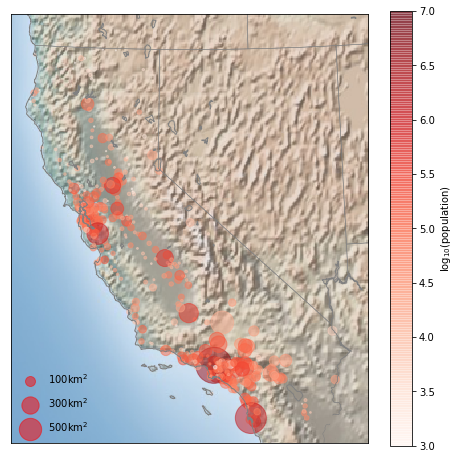

In [10]:
#Extract the data we're intersted in 
lat=cities['latd'].values
lon=cities['longd'].values
population =cities['population_total'].values
area=cities['area_total_km2'].values
#Draw the map projection and backgroudn
fig=plt.figure(figsize=(8,8))
m=Basemap(projection='lcc', resolution='h',
         lat_0=37.5, lon_0=-119,
          width=1E6, height=1.2E6)
m.shadedrelief()
m.drawcoastlines(color='gray')
m.drawstates(color='gray')
#Scatter city data, with color reflecting population and size relecting area
m.scatter(lon, lat, latlon=True, 
         c=np.log10(population), s=area,
         cmap='Reds', alpha=0.5)
#Create colorbar and legend
plt.colorbar(label=r'$\log_{10}({\rm population})$')
plt.clim(3,7)
#make legend with dummy points
for a in [100,300,500]:
    plt.scatter([],[], c='r', alpha=0.5, s=a,
               label=str(a)+'km$^2$')
plt.legend(scatterpoints=1, frameon=False, 
          labelspacing=1, loc='lower left')

In [34]:
!curl -O http://data.giss.nasa.gov/pub/gistemp/gistemp250.nc
! gunzip gistemp250.nchttps://data.giss.nasa.gov/pub/gistemp/gistemp250.nc

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100   260  100   260    0     0   2363      0 --:--:-- --:--:-- --:--:--  2363
'gunzip' is not recognized as an internal or external command,
operable program or batch file.


In [46]:
#Surface temperature data
#read netCDF format data
from netCDF4 import Dataset
data=Dataset('gistemp250.nc')

In [47]:
from netCDF4 import date2index
from datetime import datetime
timeindex = date2index(datetime(2014, 1, 15),
                       data.variables['time'])

In [48]:
lat = data.variables['lat'][:]
lon = data.variables['lon'][:]
lon, lat = np.meshgrid(lon, lat)
temp_anomaly = data.variables['tempanomaly'][timeindex]

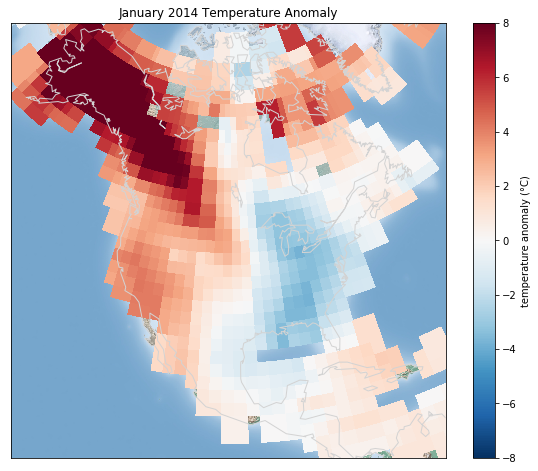

In [49]:
fig = plt.figure(figsize=(10, 8))
m = Basemap(projection='lcc', resolution='c',
            width=8E6, height=8E6, 
            lat_0=45, lon_0=-100,)
m.shadedrelief(scale=0.5)
m.pcolormesh(lon, lat, temp_anomaly,
             latlon=True, cmap='RdBu_r')
plt.clim(-8, 8)
m.drawcoastlines(color='lightgray')

plt.title('January 2014 Temperature Anomaly')
plt.colorbar(label='temperature anomaly (°C)')

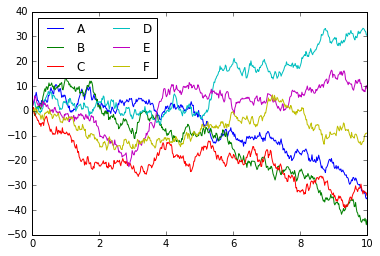

In [2]:
#visulization with seaborn
#Matplotlib vs. seabprn
import matplotlib.pyplot as plt
plt.style.use('classic')
%matplotlib inline
import numpy as np
import pandas as pd
#create some data
rng=np.random.RandomState(0)
x=np.linspace(0,10,500)
y=np.cumsum(rng.randn(500,6),0)
#Do simple plot
#plot the data with matplotlib defaults
plt.plot(x,y)
plt.legend('ABCDEF', ncol=2, loc='upper left')

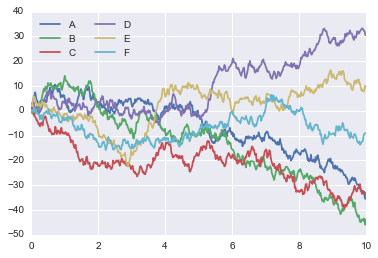

In [3]:
#HOW IT WORKS IN SEABORN
import seaborn as sns
sns.set()
#same plotting code as above
plt.plot(x,y)
plt.legend('ABCDEF', ncol=2, loc='upper left')

C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


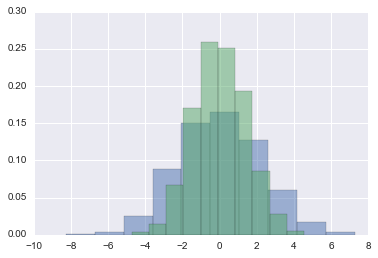

In [52]:
data=np.random.multivariate_normal([0,0],[[5,2],[2,2]], size=2000)
data=pd.DataFrame(data, columns=['x','y'])
for col in 'xy':
    plt.hist(data[col], normed=True, alpha=0.5)

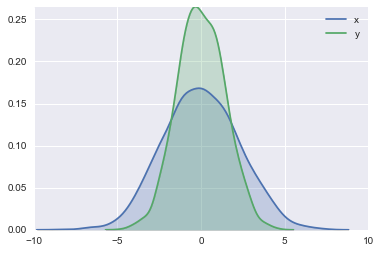

In [53]:
#Get a smooth estimate of the distribution using kernel density estimation
for col in 'xy':
    sns.kdeplot(data[col], shade=True)

C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


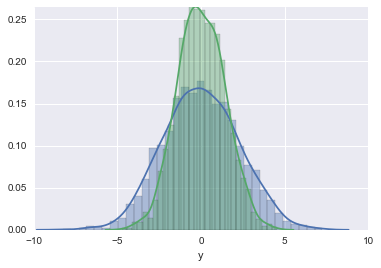

In [54]:
#combined the histogram and distplot by using distplot
for col in 'xy':
    sns.distplot(data[col])

C:\Users\chrag\Anaconda3\lib\site-packages\seaborn\distributions.py:645: UserWarning: Passing a 2D dataset for a bivariate plot is deprecated in favor of kdeplot(x, y), and it will cause an error in future versions. Please update your code.
  warnings.warn(warn_msg, UserWarning)


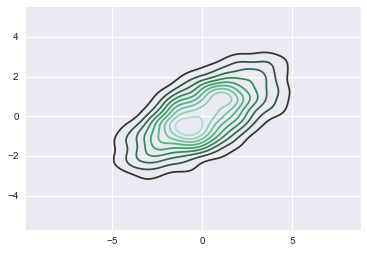

In [58]:
#TWO-D visualization of data
sns.kdeplot(data)

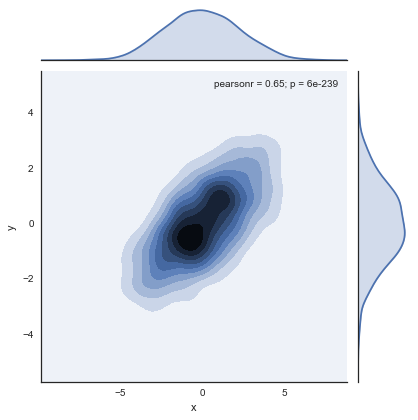

In [59]:
#Joint distribution
with sns.axes_style('white'):
    sns.jointplot('x','y',data, kind='kde')

C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


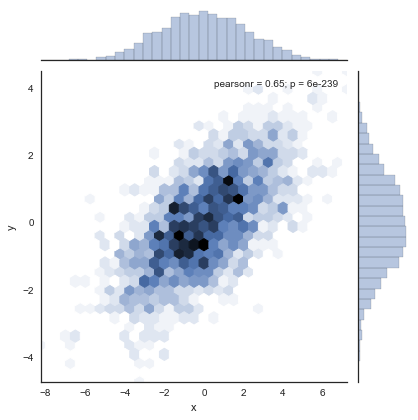

In [60]:
with sns.axes_style('white'):
    sns.jointplot('x','y',data, kind='hex')

In [61]:
#Pairplot
iris=sns.load_dataset('iris')
iris.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


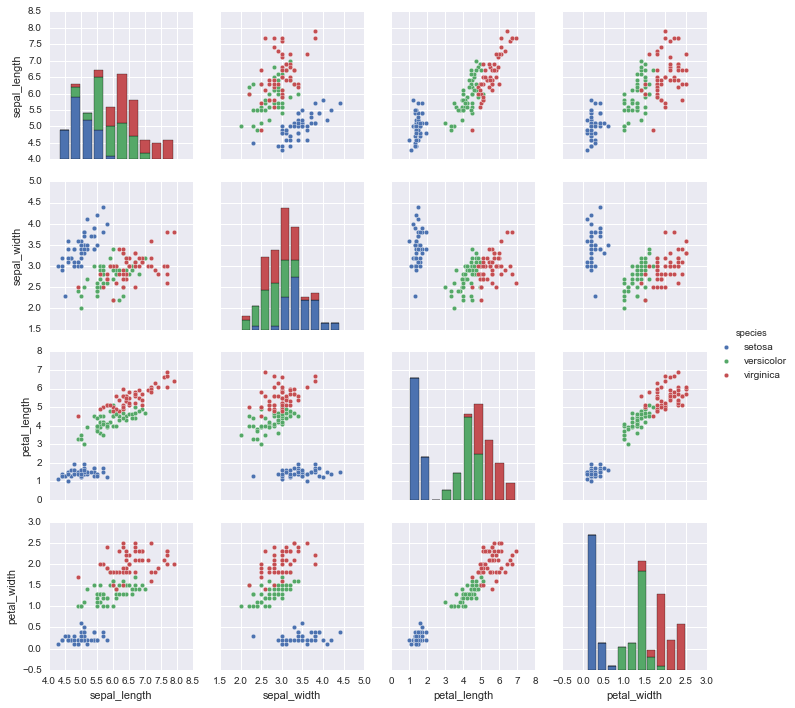

In [62]:
#Visulize the multidimensional relationship among the samples
sns.pairplot(iris, hue='species', size=2.5)

In [63]:
#Faceted Histogram
tips=sns.load_dataset('tips')
tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


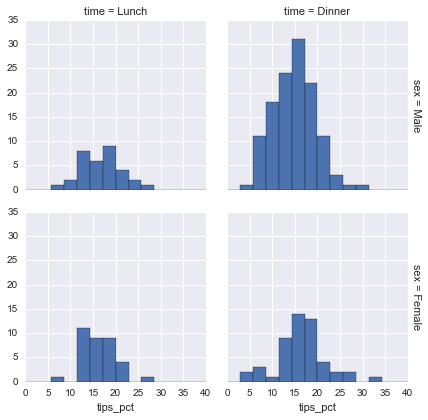

In [65]:
tips['tips_pct']=100*tips['tip']/tips['total_bill']
grid=sns.FacetGrid(tips, row='sex', col='time',
                  margin_titles=True)
grid.map(plt.hist, 'tips_pct', bins=np.linspace(0,40,15))

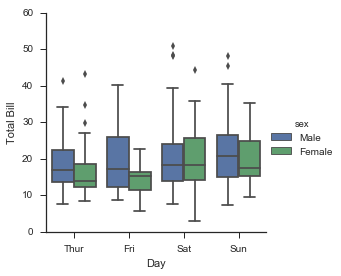

In [66]:
#Factor plots
with sns.axes_style(style='ticks'):
    g=sns.factorplot('day','total_bill','sex',data=tips, kind='box')
    g.set_axis_labels('Day', 'Total Bill')

C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


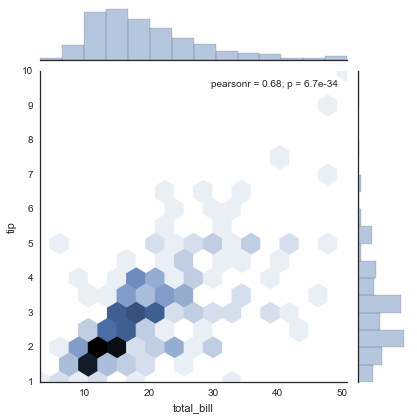

In [68]:
#Joint distribution
with sns.axes_style('white'):
    sns.jointplot('total_bill','tip',data=tips, kind='hex')

C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


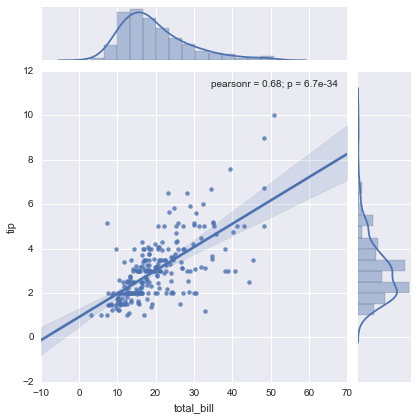

In [69]:
#regression
sns.jointplot('total_bill','tip', data=tips, kind='reg')

In [70]:
# Bar plots
planets=sns.load_dataset('planets')
planets.head()

,method,number,orbital_period,mass,distance,year
0,Radial Velocity,1,269.300,7.10,77.40,2006
1,Radial Velocity,1,874.774,2.21,56.95,2008
2,Radial Velocity,1,763.000,2.60,19.84,2011
3,Radial Velocity,1,326.030,19.40,110.62,2007
4,Radial Velocity,1,516.220,10.50,119.47,2009


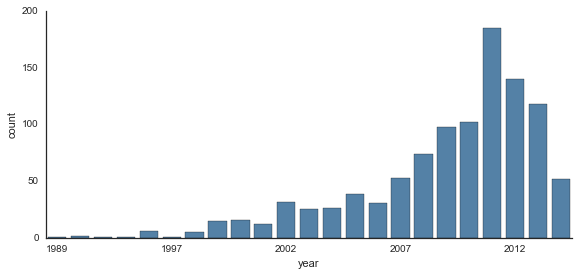

In [71]:
with sns.axes_style('white'):
    g=sns.factorplot('year', data=planets, aspect=2,
                    kind='count', color='steelblue')
    g.set_xticklabels(step=5)

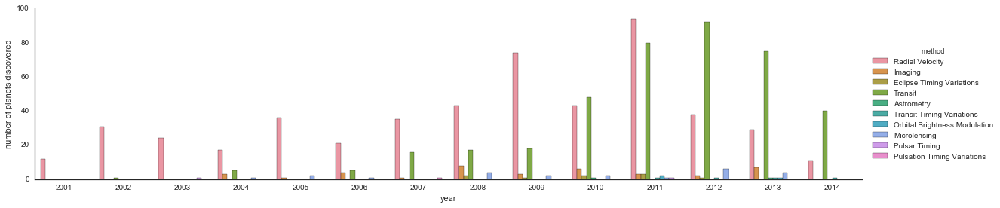

In [72]:
with sns.axes_style('white'):
    g=sns.factorplot('year', data=planets, aspect=4, kind='count',
                    hue='method', order=range(2001, 2015))
    g.set_ylabels('number of planets discovered')

In [4]:
!curl -O https://raw.githubusercontent.com/jakevdp/marathon-data/master/marathon-data.csv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0  836k    0  1918    0     0   8161      0  0:01:44 --:--:--  0:01:44  8161
100  836k  100  836k    0     0  2139k      0 --:--:-- --:--:-- --:--:-- 2139k


In [5]:
data=pd.read_csv('marathon-data.csv')
data.head()

,age,gender,split,final
0,33,M,01:05:38,02:08:51
1,32,M,01:06:26,02:09:28
2,31,M,01:06:49,02:10:42
3,38,M,01:06:16,02:13:45
4,31,M,01:06:32,02:13:59


In [76]:
data.dtypes

age        int64
gender    object
split     object
final     object
dtype: object

In [6]:
#convert string into time data
def convert_time(s):
    h,m,s=map(int, s.split(':'))
    return pd.datetools.timedelta(hours=h, minutes=m, seconds=s)
data=pd.read_csv('marathon-data.csv',
                converters={'split':convert_time, 'final': convert_time})
data.head()

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta instead.
  after removing the cwd from sys.path.
C:\Users\chrag\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: pandas.core.datetools.timedelta is deprecated. Please use datetime.timedelta inst

,age,gender,split,final
0,33,M,01:05:38,02:08:51
1,32,M,01:06:26,02:09:28
2,31,M,01:06:49,02:10:42
3,38,M,01:06:16,02:13:45
4,31,M,01:06:32,02:13:59


In [84]:
data.head()
data.dtypes

age                 int64
gender             object
split     timedelta64[ns]
final     timedelta64[ns]
dtype: object

In [7]:
data['split_sec'] = data['split'].astype('int64')/10**9
data['final_sec'] = data['final'].astype('int64')/10**9
data.head()

,age,gender,split,final,split_sec,final_sec
0,33,M,01:05:38,02:08:51,3938.0,7731.0
1,32,M,01:06:26,02:09:28,3986.0,7768.0
2,31,M,01:06:49,02:10:42,4009.0,7842.0
3,38,M,01:06:16,02:13:45,3976.0,8025.0
4,31,M,01:06:32,02:13:59,3992.0,8039.0


C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


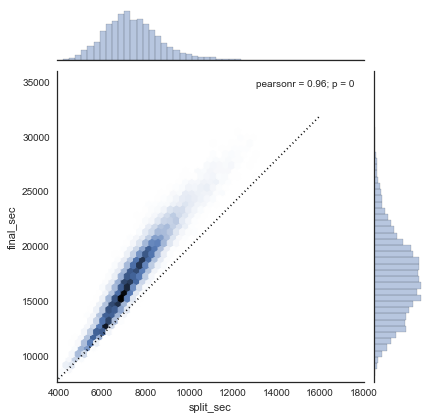

In [8]:
with sns.axes_style('white'):
    g=sns.jointplot('split_sec','final_sec', data, kind='hex')
    g.ax_joint.plot(np.linspace(4000, 16000),
                   np.linspace(8000, 32000),':k')

In [9]:
data['split_frac']=1-2*data['split_sec']/data['final_sec']
data.head()

,age,gender,split,final,split_sec,final_sec,split_frac
0,33,M,01:05:38,02:08:51,3938.0,7731.0,-0.018756
1,32,M,01:06:26,02:09:28,3986.0,7768.0,-0.026262
2,31,M,01:06:49,02:10:42,4009.0,7842.0,-0.022443
3,38,M,01:06:16,02:13:45,3976.0,8025.0,0.009097
4,31,M,01:06:32,02:13:59,3992.0,8039.0,0.006842


C:\Users\chrag\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


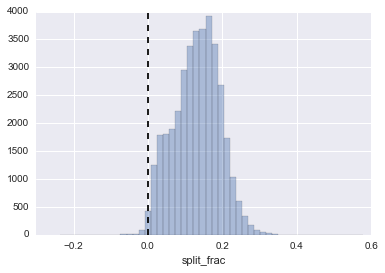

In [10]:
#distribution of the split fraction
sns.distplot(data['split_frac'],kde=False)
plt.axvline(0,color='k', linestyle='--')

In [11]:
#count how many participants are negative splits
sum(data['split_frac']<0)

251

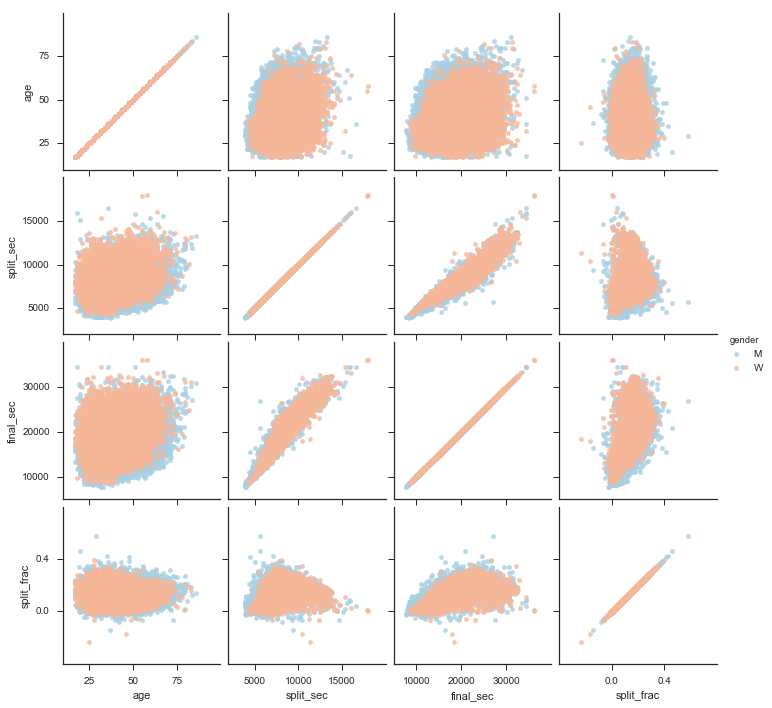

In [43]:
import matplotlib as mpl
#correlation
g=sns.PairGrid(data, vars=['age', 'split_sec','final_sec','split_frac'],
              hue='gender', palette='RdBu_r')
g.map(plt.scatter, alpha=0.8)
g.add_legend()
for ax in g.axes.flat:
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(4, prune="both"))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(4, prune="both"))
g.fig.subplots_adjust(hspace=.05, wspace=.05)

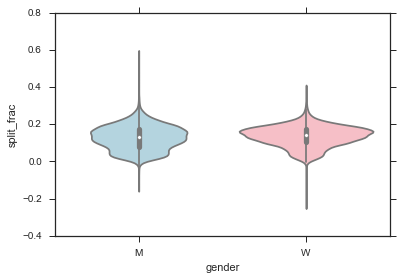

In [44]:
#VIOLINPLOT to compare the distributions 
sns.violinplot('gender', 'split_frac', data=data,
              palette=['lightblue','lightpink'])

In [45]:
#create a new column specifies the decade of age that each person is in
data['age_dec']=data.age.map(lambda age:10*(age//10))
data.head()

,age,gender,split,final,split_sec,final_sec,split_frac,age_dec
0,33,M,01:05:38,02:08:51,3938.0,7731.0,-0.018756,30
1,32,M,01:06:26,02:09:28,3986.0,7768.0,-0.026262,30
2,31,M,01:06:49,02:10:42,4009.0,7842.0,-0.022443,30
3,38,M,01:06:16,02:13:45,3976.0,8025.0,0.009097,30
4,31,M,01:06:32,02:13:59,3992.0,8039.0,0.006842,30


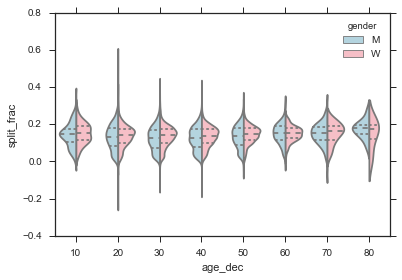

In [46]:
men=(data.gender=='M')
women=(data.gender=='W')
with sns.axes_style(style=None):
    sns.violinplot('age_dec', 'split_frac', hue='gender', data=data,
                  split=True, inner='quartile',
                  palette=['lightblue','lightpink'])


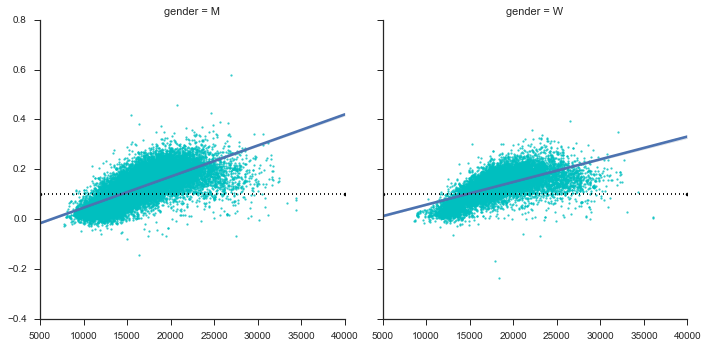

In [48]:
#plot linear regression
g=sns.lmplot('final_sec','split_frac',col='gender',data=data,
            markers='.', scatter_kws=dict(color='c'))
g.map(plt.axhline, y=0.1, color='k',ls=':')